# Realizando imports

In [1]:
import os
import sys
from pathlib import Path

sys.path.append(
    os.path.join(
        Path(os.getcwd()).parents[1],
        "src"
    )
)

In [2]:
import csv
import numpy as np
import pandas as pd
import representations
from torch import cuda
from models import AiNet
from typing import Callable
import ipywidgets as widgets
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from sklearn.manifold import TSNE
from IPython.display import display
import matplotlib.patches as mpatches
from plotly.subplots import make_subplots
from sklearn.preprocessing import MinMaxScaler

# Configurações

In [3]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

In [4]:
def plot_comparison(data_dict: dict, create_plot_func: Callable) -> go.FigureWidget:
    total_keys = len(list(data_dict.keys()))
    fig = go.FigureWidget()
    
    for key, data in data_dict.items():
        fig.add_trace(
            create_plot_func(data)
        )
            
    fig.update_layout(
        updatemenus=list(
            [
                dict(
                    buttons=list([
                        dict(
                            label="None",
                            args=[
                                {
                                    "visible": [
                                        False 
                                        for i in range(total_keys)
                                    ]
                                }
                            ],
                            method="update"
                        ),
                        *[
                            dict(
                                label=key,
                                args=[
                                    {
                                        "visible": [
                                            True if idx == i else False 
                                            for i in range(total_keys)]
                                    }
                                ],
                                method="update"
                            )
                            for idx, key in enumerate(data_dict.keys()) 
                        ]
                    ]),
                    active=0,
                    direction="down",
                    showactive=True,
                    xanchor="left",
                    x=0.0,
                )
            ]
        )
    )
        
    return fig

In [5]:
def draw_representation_dropdown() -> widgets.Dropdown:
    return widgets.Dropdown(
        options=["Nenhum", *list(representations_dict.keys())],
        description="Representação",
        disabled=False
    )

In [6]:
def render_pandas_html(data_frame: pd.DataFrame, samples: int = 5) -> widgets.HTML:
    return data_frame.head(samples).style.hide(axis="index").set_table_attributes("class=table").to_html()

In [7]:
def render_empty_table() -> widgets.HTML:
    return widgets.HTML("""
            <table>
                <thead>
                    <tr>
                        <th></th>
                        <th></th>
                    </tr>
                </thead>
                <tbody>
                    <tr>
                        <td colspan='2'>Selecione um dataset</td>
                    </tr>
                </tbody>
            </table>""")

# Importando dataset

In [8]:
dataset_path = os.path.join(
    Path(os.getcwd()).parents[1],
    "shared",
    "datasets",
    "yelp_labelled.txt"
)

os.path.exists(dataset_path)

True

In [9]:
with open(dataset_path, "r+", encoding="utf-8") as f:
    reader = csv.reader(f, delimiter="\t", quoting=csv.QUOTE_NONE)
    data = [line for line in reader]
    header = data.pop(0)

df = pd.DataFrame(columns=header, data=data)
df.head(2)

,text,label
0,Wow... Loved this place.,1
1,Crust is not good.,0


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   text    1000 non-null   object
 1   label   1000 non-null   object
dtypes: object(2)
memory usage: 15.8+ KB


In [11]:
df.describe()

,text,label
count,1000,1000
unique,996,2
top,I would not recommend this place.,1
freq,2,500


# Representations

In [12]:
representations_dict = {}

## Bert

In [13]:
bert_models_name = [
    "paraphrase-distilroberta-base-v1",
    "paraphrase-distilroberta-base-v2",
    "stsb-roberta-large",
    "distilbert-base-nli-stsb-mean-tokens"
]

In [14]:
for name in bert_models_name:
    for remove_stop_words in [True, False]:
        model = representations.SBert(
            name,
            stop_word_removal_enabled=remove_stop_words
        )
    
        columns, dbow = model.generate_representation(
            df["text"].tolist()
        )
        
        ## Normalizando 
        dbow = MinMaxScaler().fit_transform(dbow)
        
        temp_df = pd.DataFrame(dbow, columns=columns)
        
        representations_dict[f"bert_{name}_remove_stopwords_{remove_stop_words}"] = temp_df.copy()
        
        del model
        cuda.empty_cache()

Batches:   0%|          | 0/32 [00:00<?, ?it/s]

Batches:   0%|          | 0/32 [00:00<?, ?it/s]

Batches:   0%|          | 0/32 [00:00<?, ?it/s]

Batches:   0%|          | 0/32 [00:00<?, ?it/s]

Batches:   0%|          | 0/32 [00:00<?, ?it/s]

Batches:   0%|          | 0/32 [00:00<?, ?it/s]

Batches:   0%|          | 0/32 [00:00<?, ?it/s]

Batches:   0%|          | 0/32 [00:00<?, ?it/s]

## NGram ($N=1$)

### Iniciando modelo (TF-IDF)

In [15]:
model = representations.NGram(model_type="tf-idf")

In [16]:
%time
columns, dbow = model.generate_representation(df["text"].tolist())

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 7.39 µs


### Gerando DataFrame

In [17]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [18]:
(temp_df.values.min(), temp_df.values.max())

(0.0, 1.0)

In [19]:
temp_df.sample(1)

,wow,love,place,crust,good,tasty,texture,nasty,stop,late,bank,holiday,rick,steve,recommendation,selection,menu,great,price,angry,want,damn,pho,honeslty,didn,taste,fresh,potato,like,rubber,tell,ahead,time,warm,fry,touch,service,prompt,cashier,care,end,wayyy,overprice,try,cape,cod,ravoli,chicken,cranberry,mmmm,disgusted,pretty,sure,human,hair,shocked,sign,indicate,cash,highly,recommend,waitress,little,slow,worth,let,vegas,burrittos,blah,food,amazing,cute,interior,beautiful,perform,right,red,velvet,cake,ohhh,stuff,bring,salad,ask,hole,wall,mexican,street,taco,friendly,staff,hour,table,restaurant,luke,sever,run,totally,overwhelmed,bad,salmon,sashimi,combo,burger,beer,decent,deal,final,blow,find,accident,happy,quick,grab,bite,familiar,pub,favor,look,overall,lot,redeem,quality,inexpensive,ample,portion,poor,waiter,feel,stupid,come,visit,hiro,delight,suck,shrimp,tender,moist,drag,establishment,hard,judge,gross,melt,styrofoam,eat,fear,sick,positive,note,server,attentive,provide,frozen,puck,disgust,people,register,thing,prime,rib,dessert,section,generic,beef,cook,sandwich,firehouse,greek,dressing,pita,hummus,refreshing,order,duck,rare,pink,inside,nice,char,outside,realize,husband,leave,sunglass,chow,mein,horrible,attitude,customer,talk,don,enjoy,huge,wonderful,imaginative,heart,attack,grill,downtown,absolutely,flat,lined,excuse,seafood,string,pasta,sauce,power,scallop,perfectly,rip,banana,petrified,tasteless,think,refill,water,struggle,wave,minute,receive,star,appetizer,cocktail,handmade,delicious,definitely,glad,military,discount,dos,gringo,update,second,apparently,hear,salt,batter,fish,chewy,way,finish,include,tasting,drink,jeff,expect,rice,meh,min,milkshake,chocolate,milk,guess,know,excalibur,use,common,sense,dish,appalling,value,sweet,season,today,ve,lunch,buffet,cheat,waste,opportunity,company,experience,underwhelming,relationship,party,wait,person,break,walk,smell,old,grease,trap,turkey,roast,bland,pan,rave,sugary,disaster,tailor,palate,year,spring,roll,oh,yummy,meat,ratio,unsatisfying,omelet,die,summary,largely,disappointing,dining,sexy,mouth,outrageously,flirt,hot,rock,casino,step,forward,breakfast,bye,tip,lady,arrive,quickly,cafe,serve,fantastic,wife,roasted,garlic,bone,marrow,add,extra,meal,helpful,bloddy,mary,town,beat,mussel,wine,reduction,tigerlilly,afternoon,bartender,personable,ambience,music,play,trip,sooooo,real,sushi,lover,honest,yama,pass,ordering,wasn,busy,thai,spicy,check,atmosphere,kind,mess,steak,sound,actual,bit,manage,prepare,indian,cuisine,boot,worry,fine,guy,son,venture,far,away,hit,spot,night,host,lack,word,bitch,number,reason,reviewing,phenomenal,ambiance,wouldn,return,strip,pork,belly,overpriced,mediocre,penne,vodka,excellent,massive,meatloaf,crispy,wrap,delish,tuna,management,rude,nyc,bagel,cream,cheese,lox,caper,subway,fact,meet,expectation,seriously,solid,bar,extremely,dine,weekend,suggestion,rarely,disappointed,curry,bamboo,shoot,blanket,moz,cover,subpar,bathroom,clean,decorate,change,consider,pace,thumb,watch,pay,attention,ignore,fiance,middle,day,greet,seat,mandalay,bay,vain,crostini,stale,highlight,nigiri,joint,different,cut,piece,flavored,voodoo,gluten,free,ago,unfortunately,bakery,leftover,relocate,impressed,immediately,diverse,reasonably,avoid,cost,hand,phoenix,metro,area,treat,bacon,hella,salty,spinach,avocado,ingredient,sad,literally,zero,list,lordy,khao,soi,miss,terrific,thrilled,accommodation,vegetarian,daughter,catch,review,inspire,desire,modern,hip,maintain,coziness,weekly,haunt,sit,flavor,overcook,charcoal,decide,send,verge,dress,rudely,probably,dirt,healthy,quantity,lemon,raspberry,ice,incredible,imagine,interesting,decor,crepe,station,bread,butter,home,chip,original,egg,gyro,wing,satisfied,joey,vote,dog,valley,reader,magazine,bowl,live,friday,insulted,disrespect,drive,exceed,hope,dream,serivce,help,brunch,invite,foot,mixed,mushroom,yukon,gold,puree,white,corn,beateous,bug,climb,kitchen,soon,friend,tartar,win,soggy,jamaican,mojito,small,rich,accordingly,shower,rinse,mind,nude,lacking,lobs

In [20]:
representations_dict["ngram_1_tfidf"] = temp_df.copy()

### Iniciando modelo (Count)

In [21]:
model = representations.NGram(model_type="count")

In [22]:
%time
columns, dbow = model.generate_representation(df["text"].tolist())

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 8.11 µs


In [23]:
(dbow.min(), dbow.max())

(0.0, 4.0)

### Normalizando representação

In [24]:
dbow = MinMaxScaler().fit_transform(dbow)

In [25]:
(dbow.min(), dbow.max())

(0.0, 1.0)

### Gerando DataFrame

In [26]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [27]:
(temp_df.values.min(), temp_df.values.max())

(0.0, 1.0)

In [28]:
temp_df.sample(1)

,wow,love,place,crust,good,tasty,texture,nasty,stop,late,bank,holiday,rick,steve,recommendation,selection,menu,great,price,angry,want,damn,pho,honeslty,didn,taste,fresh,potato,like,rubber,tell,ahead,time,warm,fry,touch,service,prompt,cashier,care,end,wayyy,overprice,try,cape,cod,ravoli,chicken,cranberry,mmmm,disgusted,pretty,sure,human,hair,shocked,sign,indicate,cash,highly,recommend,waitress,little,slow,worth,let,vegas,burrittos,blah,food,amazing,cute,interior,beautiful,perform,right,red,velvet,cake,ohhh,stuff,bring,salad,ask,hole,wall,mexican,street,taco,friendly,staff,hour,table,restaurant,luke,sever,run,totally,overwhelmed,bad,salmon,sashimi,combo,burger,beer,decent,deal,final,blow,find,accident,happy,quick,grab,bite,familiar,pub,favor,look,overall,lot,redeem,quality,inexpensive,ample,portion,poor,waiter,feel,stupid,come,visit,hiro,delight,suck,shrimp,tender,moist,drag,establishment,hard,judge,gross,melt,styrofoam,eat,fear,sick,positive,note,server,attentive,provide,frozen,puck,disgust,people,register,thing,prime,rib,dessert,section,generic,beef,cook,sandwich,firehouse,greek,dressing,pita,hummus,refreshing,order,duck,rare,pink,inside,nice,char,outside,realize,husband,leave,sunglass,chow,mein,horrible,attitude,customer,talk,don,enjoy,huge,wonderful,imaginative,heart,attack,grill,downtown,absolutely,flat,lined,excuse,seafood,string,pasta,sauce,power,scallop,perfectly,rip,banana,petrified,tasteless,think,refill,water,struggle,wave,minute,receive,star,appetizer,cocktail,handmade,delicious,definitely,glad,military,discount,dos,gringo,update,second,apparently,hear,salt,batter,fish,chewy,way,finish,include,tasting,drink,jeff,expect,rice,meh,min,milkshake,chocolate,milk,guess,know,excalibur,use,common,sense,dish,appalling,value,sweet,season,today,ve,lunch,buffet,cheat,waste,opportunity,company,experience,underwhelming,relationship,party,wait,person,break,walk,smell,old,grease,trap,turkey,roast,bland,pan,rave,sugary,disaster,tailor,palate,year,spring,roll,oh,yummy,meat,ratio,unsatisfying,omelet,die,summary,largely,disappointing,dining,sexy,mouth,outrageously,flirt,hot,rock,casino,step,forward,breakfast,bye,tip,lady,arrive,quickly,cafe,serve,fantastic,wife,roasted,garlic,bone,marrow,add,extra,meal,helpful,bloddy,mary,town,beat,mussel,wine,reduction,tigerlilly,afternoon,bartender,personable,ambience,music,play,trip,sooooo,real,sushi,lover,honest,yama,pass,ordering,wasn,busy,thai,spicy,check,atmosphere,kind,mess,steak,sound,actual,bit,manage,prepare,indian,cuisine,boot,worry,fine,guy,son,venture,far,away,hit,spot,night,host,lack,word,bitch,number,reason,reviewing,phenomenal,ambiance,wouldn,return,strip,pork,belly,overpriced,mediocre,penne,vodka,excellent,massive,meatloaf,crispy,wrap,delish,tuna,management,rude,nyc,bagel,cream,cheese,lox,caper,subway,fact,meet,expectation,seriously,solid,bar,extremely,dine,weekend,suggestion,rarely,disappointed,curry,bamboo,shoot,blanket,moz,cover,subpar,bathroom,clean,decorate,change,consider,pace,thumb,watch,pay,attention,ignore,fiance,middle,day,greet,seat,mandalay,bay,vain,crostini,stale,highlight,nigiri,joint,different,cut,piece,flavored,voodoo,gluten,free,ago,unfortunately,bakery,leftover,relocate,impressed,immediately,diverse,reasonably,avoid,cost,hand,phoenix,metro,area,treat,bacon,hella,salty,spinach,avocado,ingredient,sad,literally,zero,list,lordy,khao,soi,miss,terrific,thrilled,accommodation,vegetarian,daughter,catch,review,inspire,desire,modern,hip,maintain,coziness,weekly,haunt,sit,flavor,overcook,charcoal,decide,send,verge,dress,rudely,probably,dirt,healthy,quantity,lemon,raspberry,ice,incredible,imagine,interesting,decor,crepe,station,bread,butter,home,chip,original,egg,gyro,wing,satisfied,joey,vote,dog,valley,reader,magazine,bowl,live,friday,insulted,disrespect,drive,exceed,hope,dream,serivce,help,brunch,invite,foot,mixed,mushroom,yukon,gold,puree,white,corn,beateous,bug,climb,kitchen,soon,friend,tartar,win,soggy,jamaican,mojito,small,rich,accordingly,shower,rinse,mind,nude,lacking,lobs

In [29]:
representations_dict["ngram_1_count"] = temp_df.copy()

## LIWC

In [30]:
del model
cuda.empty_cache()

### Carregando dicionário

In [31]:
liwc_dic = os.path.join(
    Path(os.getcwd()).parents[1],
    "shared", 
    "dictionaries",
    "liwc", 
    "LIWC2015.dic"
)

In [32]:
os.path.exists(liwc_dic)

True

### Iniciando modelo

In [33]:
model = representations.LIWC(
    liwc_dic
)

In [34]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 4 µs, sys: 2 µs, total: 6 µs
Wall time: 12.4 µs


In [35]:
(dbow.min(), dbow.max())

(0.0, 1.0)

### Gerando DataFrame

In [36]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [37]:
temp_df.sample(1)

,WC,function,pronoun,ppron,i,we,you,shehe,they,ipron,article,prep,auxverb,adverb,conj,negate,verb,adj,compare,interrog,number,quant,affect,posemo,negemo,anx,anger,sad,social,family,friend,female,male,cogproc,insight,cause,discrep,tentat,certain,differ,percept,see,hear,feel,bio,body,health,sexual,ingest,drives,affiliation,achieve,power,reward,risk,focuspast,focuspresent,focusfuture,relativ,motion,space,time,work,leisure,home,money,relig,death,informal,swear,netspeak,assent,nonflu,filler
489,0.096774,0.75,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.25,0.25,0.25,0.0,0.25,0.25,0.0,0.25,0.0,0.0,0.25,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.25,0.0,0.0


In [38]:
representations_dict["liwc"] = temp_df.copy()

## STagger

### Iniciando modelo

In [39]:
model = representations.STagger()

2025-10-05 14:47:54 INFO: Loading these models for language: en (English):
| Processor | Package         |
-------------------------------
| tokenize  | combined        |
| pos       | combined_charlm |

2025-10-05 14:47:54 INFO: Using device: cuda
2025-10-05 14:47:54 INFO: Loading: tokenize
2025-10-05 14:47:54 INFO: Loading: pos
2025-10-05 14:47:57 INFO: Done loading processors!


In [40]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 4 µs, sys: 2 µs, total: 6 µs
Wall time: 10 µs


In [41]:
(dbow.min(), dbow.max())

(0.0, 0.5714286)

### Gerando Dataframe

In [42]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [43]:
temp_df.sample(1)

,ADJ,ADP,ADV,AUX,CCONJ,CONJ,DET,EOL,INTJ,NOUN,NUM,PART,PRON,PROPN,PUNCT,SCONJ,SPACE,SYM,VERB,X
708,0.0625,0.0,0.125,0.125,0.0625,0.0,0.0,0.0,0.0,0.125,0.0,0.0625,0.125,0.0,0.125,0.0625,0.0,0.0,0.125,0.0


In [44]:
representations_dict["stagger"] = temp_df.copy()

## MRC2

In [45]:
del model
cuda.empty_cache()

In [46]:
mrc_dic = os.path.join(
    Path(os.getcwd()).parents[1],
    "shared", 
    "dictionaries",
    "mrc", 
    "mrc2.dct"
)

In [47]:
os.path.exists(mrc_dic)

True

### Iniciando modelo

In [48]:
model = representations.MRC2(mrc_dic)

2025-10-05 14:51:39 INFO: Loading these models for language: en (English):
| Processor | Package         |
-------------------------------
| tokenize  | combined        |
| pos       | combined_charlm |

2025-10-05 14:51:39 INFO: Using device: cuda
2025-10-05 14:51:39 INFO: Loading: tokenize
2025-10-05 14:51:39 INFO: Loading: pos
2025-10-05 14:51:40 INFO: Done loading processors!


In [49]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 5 µs, sys: 1e+03 ns, total: 6 µs
Wall time: 12.9 µs


In [50]:
(dbow.min(), dbow.max())

(0.0, 106477.6)

### Normalizando representação

In [51]:
dbow = MinMaxScaler().fit_transform(dbow)

In [52]:
(dbow.min(), dbow.max())

(0.0, 1.0)

### Gerando DataFrame

In [53]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [54]:
temp_df.sample(1)

,NLET,NPHON,NSYL,K-F-FREQ,K-F-NCATS,K-F-NSAMP,T-L-FREQ,BROWN-FREQ,FAM,CONC,IMAG,MEANC,MEANP,AOA,DERIVATIONAL,ABBREVIATION,SUFFIX,PREFIX,HYPHENATED,MULTI-WORD,DIALECT,ALIEN,ARCHAIC,COLLOQUIAL,CAPITAL,ERRONEOUS,NONSENSE,NONCE WORD,OBSOLETE,POETICAL,RARE,RHETORICAL,SPECIALISED,STANDARD,SUBSTANDARD,PRONUNCIATION_DIFFER_STRESS,PRONUNCIATION_DIFFER,CAPITALIZATION,PLURAL,SINGULAR,BOTH_SINGULAR_PLURAL,NO_PLURAL,PLURAL_ACT_SINGULAR
712,0.190476,0.083333,0.095238,0.021072,0.266667,0.3319,0.036684,0.056597,0.29439,0.293686,0.280588,0.222636,0.0,0.0,0.277778,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.296296,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.0,0.0


In [55]:
representations_dict["mrc2"] = temp_df.copy()

## Word2Vec

In [56]:
del model
cuda.empty_cache()

### Google News - 300

#### Iniciando modelo

In [57]:
model = representations.Word2Vec.from_trained_model('word2vec-google-news-300')

In [58]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 7 µs, sys: 2 µs, total: 9 µs
Wall time: 21 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [59]:
(dbow.min(), dbow.max())

(-0.640625, 0.81640625)

#### Normalizando representação

In [60]:
dbow = MinMaxScaler().fit_transform(dbow)

#### Gerando DataFrame

In [61]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [62]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299
16,0.484421,0.230464,0.356098,0.423295,0.408594,0.779654,0.427025,0.616162,0.513945,0.095164,0.680664,0.45065,0.373665,0.513087,0.705816,0.718421,0.034456,0.510126,0.277612,0.724837,0.563967,0.318914,0.239672,0.599734,0.460743,0.281803,0.725905,0.751424,0.180345,0.675621,0.609375,0.600656,0.355089,0.624238,0.381159,0.617468,0.340015,0.478676,0.395679,0.081646,0.532143,0.516193,0.392844,0.740324,0.204209,0.630348,0.737918,0.33125,0.442005,0.33613,0.796695,0.361188,0.166052,0.595052,0.625797,0.849678,0.610461,0.50867,0.59869,0.517888,0.544917,0.302037,0.515404,0.621235,0.204719,0.472554,0.297511,0.820231,0.338702,0.656573,0.30787,0.547944,0.474558,0.601877,0.46088,0.344309,0.79363,0.638956,0.52701,0.880976,0.552344,0.449122,0.926662,0.451324,0.631656,0.68117,0.219649,0.366921,0.557692,0.621165,0.5242,0.57413,0.686773,0.731994,1.0,0.434282,0.310405,0.461936,0.564153,0.604358,0.493527,0.464241,0.216102,0.770458,0.506319,0.483088,0.507102,0.366071,0.58,0.044444,0.852899,0.431846,0.370257,0.40046,0.756983,0.588839,0.280746,0.261364,0.615922,0.350066,0.797611,0.645495,0.471184,0.469801,0.529643,0.673929,0.626404,0.538328,0.526496,0.778032,0.732558,0.457816,0.601326,0.512752,0.53316,0.42791,0.721482,0.375,0.640982,0.705367,0.363965,0.244041,0.470373,0.426071,0.720238,0.495323,0.627942,0.334668,0.628322,0.560209,0.403043,0.362402,0.524823,0.263251,0.544985,0.266362,0.566502,0.867864,0.542835,0.471954,0.758,0.286966,0.372279,0.426352,0.532816,0.696857,0.317149,0.567232,0.42354,0.445472,0.613877,0.443667,0.358027,0.514096,0.572378,0.232432,0.384732,0.740681,0.259305,0.472398,0.719357,0.284768,0.314338,0.437675,0.183761,0.386299,0.487199,0.436087,0.49836,0.577022,0.242686,0.347851,0.517234,0.18236,0.414062,0.164603,0.601494,0.278422,0.691904,0.171764,0.802759,0.662803,0.543142,0.55052,0.374364,0.565722,0.372283,0.426519,0.504393,0.189873,0.816158,0.44535,0.588567,0.617196,0.318982,0.441562,0.597095,0.463558,0.600557,0.534884,0.501024,0.216077,0.092905,0.653444,0.937094,0.412844,0.213718,0.361186,0.785942,0.508875,0.405312,0.481266,0.671916,0.242319,0.420684,0.541633,0.281954,0.499271,0.685413,0.323026,0.332453,0.452556,0.393832,0.477315,0.466024,0.637045,0.348753,0.603242,0.41281,0.569454,0.183937,0.396674,0.379304,0.541543,0.543825,0.909551,0.352843,0.775305,0.691839,0.725892,0.842587,0.543883,0.542532,0.562252,0.434211,0.947177,0.531322,0.634973,0.415006,0.57395,0.496015,0.332051,0.453206,0.763075,0.678273,0.576762,0.608579,0.431265,0.501522,0.557333,0.536411,0.764364,0.403379,0.535221,0.730172,0.710086,0.297091,0.310936,0.542071,0.451118,0.629805,0.521859,0.955665,0.779377,0.502157,0.342754,0.435429,0.59781,0.460425,0.774452


In [63]:
representations_dict["word2vec_google_300"] = temp_df.copy()

### Train Corpus - 50 (CBOW)

#### Iniciando modelo

In [64]:
model = representations.Word2Vec(
    train_corpus=df["text"].to_list(),
    min_count=2,
    train_algorithm="cbow",
    epochs=40,
    window=5,
    vector_size=50,
    workers=8
)

In [65]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 8 µs, sys: 3 µs, total: 11 µs
Wall time: 22.6 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [66]:
(dbow.min(), dbow.max())

(-0.73725003, 0.88632715)

#### Normalizando representação

In [67]:
dbow = MinMaxScaler().fit_transform(dbow)

In [68]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [69]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [70]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49
407,0.414489,0.692945,0.411514,0.629416,0.657074,0.472031,0.512764,0.507028,0.464586,0.678857,0.571759,0.447996,0.402919,0.525778,0.509051,0.498903,0.521127,0.455538,0.46204,0.513869,0.636464,0.546129,0.505527,0.453634,0.530635,0.445016,0.610523,0.561782,0.429707,0.443824,0.359371,0.519414,0.512568,0.698754,0.457315,0.500597,0.546294,0.452423,0.499191,0.468295,0.50779,0.570539,0.509953,0.447428,0.527288,0.517297,0.389224,0.504442,0.549867,0.772691


In [71]:
representations_dict["word2vec_cbow_50"] = temp_df.copy()

### Train Corpus - 300 (CBOW)

#### Iniciando modelo

In [72]:
model = representations.Word2Vec(
    train_corpus=df["text"].tolist(),
    min_count=2,
    window=5,
    vector_size=300,
    epochs=40,
    workers=8,
    train_algorithm="cbow",
)

In [73]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 4 µs, sys: 1e+03 ns, total: 5 µs
Wall time: 10.7 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [74]:
(dbow.min(), dbow.max())

(-0.41314733, 0.52053136)

#### Normalizando representação

In [75]:
dbow = MinMaxScaler().fit_transform(dbow)

In [76]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [77]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [78]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299
949,0.370718,0.623353,0.416324,0.590247,0.549344,0.405475,0.585822,0.589962,0.586526,0.417951,0.452503,0.418692,0.636791,0.3795,0.406404,0.415697,0.586386,0.555597,0.577278,0.489391,0.407801,0.411197,0.591297,0.445828,0.577901,0.682732,0.414662,0.691389,0.371148,0.415343,0.549333,0.408311,0.59789,0.560324,0.392547,0.620092,0.514077,0.399774,0.381458,0.619258,0.405888,0.619505,0.626889,0.401082,0.613433,0.584819,0.618659,0.410586,0.519853,0.604242,0.596659,0.442766,0.401117,0.581117,0.398315,0.578876,0.567474,0.398928,0.541853,0.390385,0.40348,0.385582,0.389092,0.581204,0.555149,0.564719,0.570901,0.415923,0.41409,0.385823,0.573993,0.590258,0.586508,0.399687,0.501523,0.558108,0.413609,0.579022,0.3895,0.592532,0.427994,0.414738,0.346153,0.593517,0.56421,0.402392,0.411748,0.498309,0.586021,0.232173,0.58401,0.400117,0.571403,0.501029,0.596043,0.598252,0.589167,0.410755,0.4404,0.588115,0.388381,0.654458,0.592388,0.537589,0.600624,0.390908,0.405168,0.441235,0.402884,0.631247,0.405424,0.413679,0.440767,0.591616,0.591423,0.555753,0.424644,0.628039,0.597709,0.40716,0.593124,0.593954,0.628927,0.473976,0.424611,0.576032,0.611041,0.414188,0.435829,0.594311,0.606775,0.611322,0.400167,0.372205,0.62932,0.581123,0.422624,0.425556,0.415208,0.413695,0.583796,0.378011,0.206049,0.597197,0.612502,0.401789,0.407599,0.454202,0.578842,0.399363,0.457781,0.414435,0.420205,0.412225,0.531379,0.567781,0.401548,0.338613,0.341934,0.592489,0.565394,0.617093,0.406585,0.603377,0.396558,0.570018,0.616176,0.437845,0.578755,0.604433,0.417082,0.608081,0.577479,0.611141,0.56741,0.611286,0.327088,0.400871,0.552215,0.408992,0.397708,0.581081,0.409648,0.369128,0.42416,0.595689,0.600049,0.598445,0.528897,0.417559,0.595019,0.570245,0.421599,0.529959,0.656306,0.419581,0.515908,0.395624,0.570171,0.398473,0.401613,0.590997,0.524741,0.368968,0.488366,0.363044,0.39371,0.599434,0.508033,0.382932,0.517372,0.409978,0.389816,0.400095,0.581519,0.412777,0.412561,0.410895,0.408508,0.399337,0.586167,0.379317,0.431577,0.401693,0.404472,0.423082,0.388949,0.407176,0.432617,0.648297,0.591559,0.468585,0.405357,0.586995,0.399542,0.59655,0.466342,0.452663,0.576555,0.401962,0.604907,0.424591,0.43611,0.500114,0.591133,0.420588,0.414714,0.630929,0.385607,0.583149,0.591134,0.504534,0.668318,0.605793,0.407275,0.387254,0.587156,0.583378,0.415557,0.419216,0.618535,0.575499,0.5874,0.411674,0.426619,0.392811,0.569723,0.60278,0.4114,0.583343,0.393057,0.542404,0.484449,0.45571,0.582867,0.585597,0.584475,0.599484,0.406805,0.451957,0.597647,0.580269,0.597763,0.583566,0.613386,0.340993,0.401688,0.609991,0.436238,0.580637,0.460746,0.591924,0.598254,0.511983,0.587434,0.595297,0.697957,0.413516,0.624589,0.395039


In [79]:
representations_dict["word2vec_cbow_300"] = temp_df.copy()

### Train Corpus - 50 (skip-gram)

#### Iniciando modelo

In [80]:
model = representations.Word2Vec(
    train_corpus=df["text"].tolist(),
    min_count=2,
    window=5,
    epochs=40,
    vector_size=50,
    workers=8,
    train_algorithm="skip-gram",
)

In [81]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 8 µs, sys: 3 µs, total: 11 µs
Wall time: 20.7 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [82]:
(dbow.min(), dbow.max())

(-0.49263662, 0.69720966)

#### Normalizando representação

In [83]:
dbow = MinMaxScaler().fit_transform(dbow)

In [84]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [85]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [86]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49
125,0.494625,0.633806,0.334414,0.620441,0.830652,0.649923,0.284314,0.476976,0.616457,0.491157,0.778717,0.80548,0.515617,0.648995,0.542331,0.287248,0.314121,0.34962,0.61966,0.666509,0.568217,0.42477,0.222627,0.669661,0.358303,0.281358,0.681642,0.738011,0.552171,0.177696,0.377187,0.276597,0.645474,0.585361,0.719876,0.35083,0.653795,0.193607,0.294469,0.534713,0.389086,0.508662,0.742303,0.537702,0.379362,0.219425,0.37406,0.603443,0.344786,0.691557


In [87]:
representations_dict["word2vec_skipgram_50"] = temp_df.copy()

### Train Corpus - 300 (skip-gram)

#### Iniciando modelo

In [88]:
model = representations.Word2Vec(
    train_corpus=df["text"].tolist(),
    min_count=2,
    window=5,
    epochs=40,
    vector_size=300,
    workers=8,
    train_algorithm="skip-gram",
)

In [89]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 5 µs, sys: 2 µs, total: 7 µs
Wall time: 12.2 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [90]:
(dbow.min(), dbow.max())

(-0.24860232, 0.23995641)

#### Normalizando representação

In [91]:
dbow = MinMaxScaler().fit_transform(dbow)

In [92]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [93]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [94]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299
261,0.613503,0.56884,0.310075,0.52706,0.407272,0.480102,0.595124,0.771963,0.5368,0.559553,0.255495,0.410719,0.622932,0.344345,0.603166,0.360895,0.633189,0.473663,0.545662,0.292241,0.713365,0.367301,0.676451,0.401781,0.542639,0.526682,0.283822,0.712395,0.67517,0.29156,0.186315,0.446645,0.515223,0.511182,0.407777,0.506302,0.369661,0.2549,0.392067,0.565893,0.396619,0.319061,0.65504,0.288291,0.510886,0.687802,0.548663,0.533218,0.767309,0.487755,0.714031,0.367629,0.617222,0.708861,0.316361,0.715894,0.469828,0.426942,0.459239,0.271821,0.637721,0.379021,0.590859,0.552676,0.388305,0.684823,0.464626,0.76919,0.280683,0.401059,0.77468,0.607675,0.711379,0.378636,0.383689,0.316845,0.439821,0.651995,0.286933,0.659245,0.261744,0.567948,0.418195,0.710366,0.603955,0.391528,0.277548,0.559781,0.571061,0.278026,0.734362,0.266148,0.570685,0.596771,0.703775,0.600912,0.697575,0.513618,0.466844,0.667994,0.536501,0.562584,0.715717,0.54443,0.452902,0.368016,0.416605,0.285463,0.297861,0.567788,0.400462,0.630602,0.32886,0.470251,0.602615,0.606036,0.68828,0.602201,0.695621,0.512791,0.489701,0.377401,0.731257,0.515586,0.395329,0.7052,0.435149,0.265494,0.340618,0.589126,0.428668,0.631588,0.328982,0.3808,0.534881,0.33364,0.403538,0.3965,0.294739,0.286796,0.484552,0.43918,0.589688,0.689124,0.600462,0.373233,0.358253,0.37912,0.664171,0.491244,0.388961,0.240568,0.300452,0.290508,0.440003,0.548196,0.450685,0.609576,0.526199,0.791137,0.546724,0.609584,0.303766,0.701946,0.323388,0.529784,0.459492,0.678979,0.454058,0.578003,0.365547,0.646371,0.658676,0.738337,0.374598,0.330365,0.495658,0.320756,0.331327,0.203549,0.336859,0.723471,0.375592,0.370594,0.438156,0.745121,0.668753,0.742055,0.537104,0.301812,0.502961,0.572636,0.30457,0.654325,0.673065,0.330719,0.633924,0.207871,0.410508,0.376358,0.266298,0.656246,0.61742,0.527795,0.478584,0.280329,0.393799,0.502221,0.60823,0.361762,0.516045,0.252311,0.358645,0.226648,0.711474,0.44048,0.494472,0.237704,0.294675,0.303706,0.513088,0.563735,0.317682,0.497461,0.351194,0.413773,0.144008,0.465485,0.387942,0.631619,0.492906,0.288917,0.611316,0.599847,0.295299,0.591227,0.568922,0.601398,0.27361,0.285006,0.616627,0.365624,0.459004,0.385913,0.464683,0.27069,0.209266,0.300193,0.171841,0.613959,0.533527,0.53124,0.623758,0.528224,0.374645,0.261412,0.759846,0.608392,0.30405,0.352587,0.533099,0.500682,0.585829,0.257055,0.417159,0.405368,0.621818,0.453173,0.287787,0.591623,0.302117,0.742724,0.686769,0.511688,0.674876,0.53101,0.546337,0.515057,0.286806,0.640021,0.588014,0.498826,0.591455,0.479284,0.646388,0.642396,0.27055,0.679693,0.413411,0.638341,0.695638,0.723012,0.582364,0.482352,0.770102,0.697673,0.434777,0.327197,0.693778,0.534352


In [95]:
representations_dict["word2vec_skipgram_300"] = temp_df.copy()

## fastText

### Train Corpus - 50 (CBOW)

#### Iniciando modelo

In [96]:
model = representations.FastText(
    train_corpus=df["text"].tolist(),
    min_count=2,
    train_algorithm="cbow",
    window=5,
    epochs=40,
    vector_size=50,
    workers=8
)

In [97]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 5 µs, sys: 1e+03 ns, total: 6 µs
Wall time: 13.4 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [98]:
(dbow.min(), dbow.max())

(-1.0042729, 1.061729)

#### Normalizando representação

In [99]:
dbow = MinMaxScaler().fit_transform(dbow)

In [100]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [101]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [102]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49
221,0.588086,0.454746,0.306562,0.484012,0.511143,0.793229,0.70455,0.603997,0.606406,0.451134,0.694427,0.630538,0.440777,0.397702,0.580535,0.233089,0.629703,0.636201,0.383816,0.618894,0.539555,0.418096,0.415997,0.601004,0.362448,0.403298,0.374569,0.608877,0.576431,0.305818,0.789588,0.567964,0.327042,0.450897,0.383364,0.422284,0.574697,0.330893,0.470814,0.587604,0.440723,0.357876,0.57799,0.393098,0.498133,0.506594,0.526373,0.570213,0.495702,0.516412


In [103]:
representations_dict["fasttext_cbow_50"] = temp_df.copy()

### Train Corpus - 300 (CBOW)

#### Iniciando modelo

In [104]:
model = representations.FastText(
    train_corpus=df["text"].tolist(),
    min_count=2,
    train_algorithm="cbow",
    window=5,
    epochs=40,
    vector_size=300,
    workers=8
)

In [105]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 5 µs, sys: 1e+03 ns, total: 6 µs
Wall time: 15 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [106]:
(dbow.min(), dbow.max())

(-0.5144977, 0.48148793)

#### Normalizando representação

In [107]:
dbow = MinMaxScaler().fit_transform(dbow)

In [108]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [109]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [110]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299
825,1.0,0.0,0.924991,0.345847,1.0,0.890526,0.965144,0.0,0.556142,0.0,0.843505,0.729447,1.0,0.186968,0.266121,0.0,0.635302,1.0,0.437625,0.227606,1.0,0.182291,0.061416,1.0,0.136667,0.610252,0.0,0.372666,0.122852,0.901908,0.500188,0.72528,0.0,0.799601,1.0,0.012353,0.0,1.0,0.0,0.907602,0.143175,0.782537,0.0,1.0,0.646137,0.524111,1.0,0.019817,0.545613,0.0,0.465481,0.071853,0.244353,0.140489,0.810597,0.0,0.166079,0.0,0.681597,0.0,0.353732,1.0,0.401112,1.0,1.0,0.835979,1.0,1.0,0.494055,0.826679,0.199952,0.528805,0.927978,0.123143,0.0,0.332621,0.086865,0.58229,0.470545,0.0,0.511675,1.0,0.615144,0.0,1.0,1.0,1.0,0.520582,0.0,0.0,0.220804,0.266195,0.661279,1.0,0.073451,0.0,0.10084,1.0,1.0,0.0,0.310653,1.0,1.0,0.0,0.578843,0.019959,1.0,0.321339,0.618017,0.574232,0.743409,0.224599,0.893394,0.547309,0.477285,0.403594,0.379509,0.403282,0.0,0.250751,0.524557,0.075269,0.202716,1.0,0.907688,0.945212,0.608264,0.0,0.660864,0.163472,0.714399,0.514177,0.785695,0.336328,1.0,0.0,0.787353,0.663771,0.933812,0.408232,0.0,0.154343,0.0,0.387124,0.058595,1.0,0.305319,0.075797,1.0,0.77756,0.528067,1.0,0.426719,0.30017,0.928306,0.402759,1.0,1.0,0.069666,0.991213,0.973506,0.80088,0.666494,0.0,0.048295,0.376744,0.870226,0.0,0.41097,0.159563,1.0,0.044788,0.0,0.0,0.379097,1.0,0.0,1.0,0.464375,0.955588,1.0,0.606298,0.0,0.647102,0.216797,0.858102,0.479099,0.09507,0.556427,0.171699,0.554812,0.468298,0.535509,0.650006,0.128817,0.807152,1.0,1.0,0.867491,0.466169,0.037234,1.0,0.700128,0.756761,0.685672,0.114111,0.327026,0.769613,0.932363,0.781436,0.313836,0.597177,0.806287,1.0,0.657347,1.0,0.777872,0.32307,0.20982,0.0,0.0,1.0,0.844613,0.935164,0.89145,0.0,0.568277,0.0,0.027048,0.664884,0.0,0.693941,0.621737,0.420769,0.236488,0.090152,1.0,0.674148,0.479055,0.747537,1.0,0.0,0.0,0.924667,1.0,0.929626,0.0,0.066281,0.381985,0.0,1.0,1.0,0.35714,0.181796,1.0,0.0,0.236139,0.0,1.0,0.858276,0.770173,0.0,0.641044,1.0,0.949445,1.0,1.0,0.464906,0.859204,0.0,0.881615,0.635981,1.0,0.052529,0.032924,0.960755,0.301241,1.0,0.100179,0.740611,0.511287,0.450841,0.377083,0.0,0.707278,0.0,1.0,0.167846,0.306224,0.061648,0.352449,0.0,0.237461,0.743042,1.0,1.0,0.528997,0.001194,0.751443,0.0


In [111]:
representations_dict["fasttext_cbow_300"] = temp_df.copy()

### Train Corpus - 50 (skip-gram)

#### Iniciando modelo

In [112]:
model = representations.FastText(
    train_corpus=df["text"].tolist(),
    min_count=2,
    window=5,
    epochs=40,
    vector_size=50,
    train_algorithm="skip-gram",
    workers=8
)

In [113]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 4 µs, sys: 1e+03 ns, total: 5 µs
Wall time: 13.8 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [114]:
(dbow.min(), dbow.max())

(-1.1377838, 1.3898758)

#### Normalizando representação

In [115]:
dbow = MinMaxScaler().fit_transform(dbow)

In [116]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [117]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [118]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49
888,0.566898,0.627021,0.549553,0.523768,0.552577,0.665907,0.646791,0.457463,0.606713,0.513203,0.387119,0.398704,0.51788,0.626087,0.509658,0.308258,0.487483,0.300581,0.489914,0.550831,0.530746,0.51046,0.547134,0.705992,0.400035,0.512127,0.600441,0.460885,0.533095,0.382982,0.433854,0.576917,0.419472,0.330417,0.356192,0.454926,0.441457,0.230008,0.56121,0.600006,0.403529,0.548276,0.569951,0.580204,0.558585,0.556469,0.691904,0.374007,0.514116,0.367969


In [119]:
representations_dict["fasttext_skipgram_50"] = temp_df.copy()

### Train Corpus - 300 (skip-gram)

#### Iniciando modelo

In [120]:
model = representations.FastText(
    train_corpus=df["text"].tolist(),
    min_count=2,
    window=5,
    epochs=40,
    train_algorithm="skip-gram",
    vector_size=300,
    workers=8
)

In [121]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 4 µs, sys: 1e+03 ns, total: 5 µs
Wall time: 11.2 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [122]:
(dbow.min(), dbow.max())

(-0.49959788, 0.48409915)

#### Normalizando representação

In [123]:
dbow = MinMaxScaler().fit_transform(dbow)

In [124]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [125]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [126]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299
925,0.6887,0.553535,0.571097,0.645448,0.671526,0.220808,0.420649,0.615229,0.461613,0.526169,0.650682,0.351891,0.529925,0.45152,0.670119,0.753874,0.496477,0.750721,0.564819,0.622446,0.692195,0.496674,0.593991,0.337124,0.524675,0.53716,0.544882,0.635813,0.315739,0.594638,0.545614,0.218321,0.545405,0.717445,0.492344,0.463409,0.699572,0.477925,0.549703,0.393416,0.583621,0.334884,0.577521,0.729363,0.749383,0.30207,0.408721,0.339331,0.317854,0.509198,0.739739,0.391786,0.383964,0.619865,0.625364,0.632349,0.382531,0.582962,0.606124,0.412234,0.614071,0.700823,0.50164,0.509469,0.55492,0.711791,0.257662,0.365964,0.458802,0.399615,0.586691,0.491702,0.525498,0.2504,0.727639,0.547686,0.507922,0.459642,0.779624,0.756295,0.245654,0.192009,0.643836,0.498642,0.242897,0.880464,0.383327,0.759995,0.353025,0.266884,0.662502,0.583776,0.514553,0.86135,0.666269,0.526391,0.711537,0.769578,0.539664,0.318705,0.205918,0.474284,0.652779,0.574705,0.181993,0.362196,0.670162,0.641126,0.220231,0.358754,0.39161,0.55758,0.148233,0.399921,0.5054,0.783196,0.46521,0.686008,0.550429,0.669303,0.581491,0.195283,0.665977,0.48279,0.625789,0.716482,0.475769,0.558978,0.581915,0.520629,0.36391,0.337542,0.843285,0.618537,0.441925,0.579839,0.159433,0.740737,0.283756,0.268093,0.476146,0.399214,0.323229,0.49043,0.280985,0.831208,0.505356,0.316976,0.388722,0.693877,0.40042,0.602428,0.671901,0.424345,0.39466,0.524232,0.300936,0.81725,0.582026,0.57465,0.650229,0.280109,0.356192,0.370404,0.403051,0.306236,0.380979,0.641068,0.214813,0.588919,0.507779,0.351882,0.460539,0.316312,0.57502,0.599773,0.269974,0.490364,0.388886,0.828012,0.413305,0.283117,0.501038,0.707019,0.385654,0.420103,0.70883,0.426423,0.593879,0.690082,0.715643,0.477112,0.71198,0.515478,0.570179,0.433163,0.656224,0.580482,0.579773,0.293583,0.362459,0.435998,0.570003,0.699057,0.56755,0.43838,0.35511,0.354187,0.492592,0.714417,0.662762,0.148208,0.495263,0.49723,0.553645,0.454148,0.437381,0.565685,0.607679,0.789326,0.307585,0.585672,0.446886,0.317964,0.955115,0.439348,0.603511,0.348721,0.450149,0.514883,0.611369,0.379431,0.426869,0.611861,0.483367,0.60542,0.356393,0.415259,0.613086,0.593959,0.495953,0.492489,0.303612,0.347047,0.668992,0.351176,0.485246,0.382535,0.61156,0.868708,0.403355,0.486335,0.606322,0.375058,0.444281,0.45637,0.831751,0.543041,0.261683,0.32506,0.485358,0.3126,0.885897,0.567927,0.626797,0.160525,0.273876,0.576814,0.493929,0.265496,0.259744,0.494847,0.627464,0.331187,0.655843,0.330378,0.334577,0.384207,0.149782,0.413475,0.50597,0.802454,0.334696,0.679785,0.778618,0.539049,0.346786,0.402129,0.667082,0.313181,0.419802,0.535536,0.257662,0.495553,0.313253,0.52572,0.414193,0.391516,0.427878,0.524193


In [127]:
representations_dict["fasttext_skipgram_300"] = temp_df.copy()

## Doc2Vec

### Train Corpus - 50 (PV-DBOW)

#### Iniciando modelo

In [128]:
model = representations.Doc2Vec(
    train_corpus=df["text"].tolist(),
    min_count=2,
    window=5,
    epochs=40,
    vector_size=50,
    workers=8,
    train_algorithm ="pv-dbow",
)

In [129]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 4 µs, sys: 1e+03 ns, total: 5 µs
Wall time: 9.3 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [130]:
(dbow.min(), dbow.max())

(-0.45606998, 0.85637736)

#### Normalizando representação

In [131]:
dbow = MinMaxScaler().fit_transform(dbow)

In [132]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [133]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [134]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49
737,0.245407,0.418339,0.319616,0.696335,0.675815,0.298993,0.631862,0.682052,0.617436,0.632616,0.63769,0.306902,0.690055,0.310304,0.645104,0.310966,0.334118,0.667415,0.364107,0.798492,0.342963,0.260486,0.362828,0.339105,0.333872,0.360257,0.30558,0.346658,0.663494,0.707026,0.696989,0.315063,0.313067,0.325921,0.656269,0.277523,0.338848,0.577285,0.231739,0.305212,0.266137,0.72567,0.620543,0.588541,0.29226,0.358235,0.368618,0.667865,0.694207,0.315077


In [135]:
representations_dict["doc2vec_pv_dbow_50"] = temp_df.copy()

### Train Corpus - 300 (PV-DBOW)

#### Iniciando modelo

In [136]:
model = representations.Doc2Vec(
    train_corpus=df["text"].tolist(),
    min_count=2,
    window=5,
    epochs=40,
    vector_size=300,
    workers=8,
    train_algorithm ="pv-dbow",
)

In [137]:
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [138]:
(dbow.min(), dbow.max())

(-0.34349638, 0.34814942)

#### Normalizando representação

In [139]:
dbow = MinMaxScaler().fit_transform(dbow)

In [140]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [141]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [142]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299
978,0.520652,0.484655,0.531098,0.485148,0.523251,0.515677,0.481715,0.482786,0.428532,0.546297,0.805049,0.531275,0.472731,0.509071,0.493435,0.51857,0.482896,0.492195,0.472586,0.519734,0.509445,0.432211,0.512559,0.492823,0.64015,0.458865,0.507756,0.510822,0.510417,0.494624,0.521585,0.483045,0.484957,0.481226,0.419839,0.496844,0.735093,0.501131,0.486839,0.487355,0.52379,0.491404,0.488951,0.489538,0.493719,0.328283,0.440611,0.496947,0.504759,0.491997,0.510104,0.717921,0.510773,0.510259,0.485729,0.477421,0.506943,0.488172,0.706121,0.525386,0.529224,0.546731,0.482982,0.471642,0.516676,0.489356,0.520466,0.481336,0.52389,0.466151,0.529341,0.524519,0.465342,0.514855,0.516731,0.520186,0.480144,0.508555,0.479413,0.506989,0.457284,0.502108,0.59007,0.53199,0.519284,0.501839,0.530872,0.502403,0.520831,0.447921,0.47489,0.509937,0.493871,0.484141,0.480009,0.539745,0.55073,0.456717,0.529954,0.590087,0.540814,0.490978,0.657651,0.492543,0.504473,0.499094,0.400432,0.423125,0.471968,0.499227,0.532338,0.474294,0.517873,0.417095,0.521598,0.43522,0.49265,0.316586,0.601433,0.490843,0.49432,0.429521,0.514895,0.512772,0.563664,0.491086,0.412888,0.51706,0.52566,0.49655,0.522366,0.518909,0.486774,0.4755,0.495425,0.509196,0.486482,0.463594,0.356424,0.508155,0.500158,0.368538,0.5103,0.462259,0.578575,0.490234,0.496671,0.49227,0.653183,0.51148,0.498697,0.498888,0.516379,0.465874,0.506192,0.524272,0.515542,0.327011,0.513617,0.510039,0.554537,0.487578,0.538077,0.524167,0.52003,0.535656,0.539597,0.495807,0.525118,0.542048,0.608971,0.507222,0.676167,0.475002,0.478753,0.502737,0.504921,0.520001,0.539639,0.590068,0.459365,0.500413,0.387235,0.513885,0.557592,0.511098,0.448709,0.491869,0.462418,0.507898,0.511167,0.501199,0.49528,0.512879,0.52188,0.471516,0.514505,0.509457,0.498286,0.522015,0.493203,0.490965,0.516852,0.478669,0.496092,0.493956,0.487299,0.520222,0.523976,0.485857,0.515241,0.505729,0.526226,0.476455,0.477365,0.471387,0.455185,0.495824,0.50041,0.455763,0.514914,0.476615,0.481685,0.475667,0.526488,0.497684,0.534844,0.508378,0.48051,0.494711,0.498975,0.480764,0.458457,0.44357,0.491861,0.512626,0.486468,0.476653,0.502032,0.512778,0.484433,0.537309,0.517774,0.517758,0.392322,0.521838,0.496472,0.513708,0.489189,0.504099,0.520405,0.521328,0.499159,0.521462,0.477946,0.537021,0.475579,0.436104,0.478948,0.515749,0.522469,0.4917,0.490214,0.477651,0.499334,0.49861,0.504467,0.487436,0.512158,0.602781,0.439735,0.520598,0.489991,0.523753,0.490452,0.484345,0.465804,0.477253,0.501709,0.504647,0.527792,0.505723,0.470438,0.482021,0.505225,0.531122,0.476188,0.489101,0.515754,0.528567,0.510383,0.516982,0.522361,0.468184,0.452516,0.471842,0.478404,0.358029,0.487632,0.432262


In [143]:
representations_dict["doc2vec_pv_dbow_300"] = temp_df.copy()

### Train Corpus - 50 (PV-DM)

#### Iniciando modelo

In [144]:
model = representations.Doc2Vec(
    train_corpus=df["text"].tolist(),
    min_count=2,
    window=5,
    epochs=40,
    vector_size=50,
    workers=8,
    train_algorithm ="pv-dm"
)

In [145]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 4 µs, sys: 1e+03 ns, total: 5 µs
Wall time: 12.4 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [146]:
(dbow.min(), dbow.max())

(-0.3651088, 0.5425956)

#### Normalizando representação

In [147]:
dbow = MinMaxScaler().fit_transform(dbow)

In [148]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [149]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [150]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49
488,0.728547,0.765018,0.915842,0.110487,0.0,0.009401,0.883057,0.928021,0.092247,0.076195,0.161985,0.185669,0.55494,0.843544,0.071016,0.913529,0.923849,0.48063,0.107642,0.084083,0.530083,0.904597,0.895812,0.61559,0.910865,0.888462,0.149499,0.163964,0.079299,0.301331,0.291213,0.953252,0.132213,0.93663,0.087125,0.882275,0.955689,0.563111,0.927315,0.087846,0.909929,0.061277,0.188431,0.715828,0.93149,0.926265,0.847015,0.0383,1.0,0.961801


In [151]:
representations_dict["doc2vec_pv_dm_50"] = temp_df.copy()

### Train Corpus - 300 (PV-DM)

#### Iniciando modelo

In [152]:
model = representations.Doc2Vec(
    train_corpus=df["text"].tolist(),
    min_count=2,
    window=5,
    epochs=40,
    vector_size=300,
    workers=8,
    train_algorithm ="pv-dm",
)

In [153]:
%time
columns, dbow = model.generate_representation(
    df["text"].tolist()
)

CPU times: user 4 µs, sys: 1e+03 ns, total: 5 µs
Wall time: 11.9 µs


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [154]:
(dbow.min(), dbow.max())

(-0.23470299, 0.29206938)

#### Normalizando representação

In [155]:
dbow = MinMaxScaler().fit_transform(dbow)

In [156]:
(dbow.min(), dbow.max())

(0.0, 1.0000001)

#### Gerando DataFrame

In [157]:
temp_df = pd.DataFrame(dbow, columns=columns)

In [158]:
temp_df.sample(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299
920,0.309669,0.775835,0.798227,0.750237,0.696222,0.242635,0.734847,0.749626,0.718214,0.259712,0.214155,0.227279,0.724852,0.813291,0.269121,0.266168,0.726303,0.706682,0.795175,0.650062,0.322042,0.237272,0.739226,0.276612,0.768463,0.460486,0.259822,0.136402,0.25959,0.254575,0.660847,0.24195,0.514024,0.697643,0.37319,0.728905,0.67176,0.261009,0.297283,0.303306,0.258561,0.76294,0.722069,0.257664,0.7822,0.705647,0.675117,0.213386,0.242678,0.762946,0.724825,0.649825,0.542717,0.745192,0.26255,0.72671,0.760585,0.237947,0.450604,0.278338,0.263835,0.291419,0.214245,0.299836,0.449636,0.730011,0.713875,0.275058,0.257575,0.271676,0.788808,0.742181,0.74821,0.254589,0.708529,0.827885,0.240745,0.819569,0.277843,0.761021,0.263768,0.251713,0.69197,0.742167,0.697797,0.208885,0.251706,0.716283,0.733382,0.737695,0.748576,0.19911,0.722374,0.927153,0.723734,0.76311,0.761823,0.262221,0.470872,0.752995,0.265372,0.277476,0.751385,0.644672,0.70492,0.261527,0.263394,0.340534,0.241807,0.727262,0.263883,0.263071,0.712752,0.755376,0.736009,0.679515,0.212151,0.599283,0.739638,0.256948,0.743611,0.738833,0.748011,0.461806,0.235955,0.551691,0.729813,0.251371,0.544319,0.729582,0.760042,0.736103,0.232694,0.237147,0.771243,0.741689,0.287633,0.269027,0.250861,0.25002,0.233676,0.268891,0.613498,0.750803,0.699523,0.266675,0.255703,0.258989,0.786232,0.247848,0.349307,0.256686,0.28094,0.203776,0.81614,0.74114,0.257333,0.202312,0.258933,0.737122,0.749279,0.748567,0.271752,0.753482,0.282602,0.741126,0.753465,0.238584,0.798051,0.74327,0.246719,0.886607,0.76604,0.756004,0.118087,0.772802,0.304701,0.304725,0.766469,0.23769,0.261415,0.737402,0.261635,0.258479,0.721818,0.573635,0.744246,0.739652,0.777165,0.232883,0.747881,0.738674,0.264656,0.780825,0.760118,0.271239,0.666187,0.242711,0.772817,0.649843,0.243271,0.780999,0.759564,0.249338,0.745113,0.204568,0.255395,0.788274,0.631196,0.270275,0.234147,0.251275,0.252906,0.223609,0.709813,0.255934,0.252454,0.265033,0.268565,0.262524,0.748699,0.211717,0.25473,0.263839,0.178809,0.259206,0.222371,0.266293,0.255542,0.738467,0.753896,0.289832,0.25309,0.752715,0.258828,0.761417,0.312824,0.317776,0.757073,0.249058,0.750402,0.88467,0.826806,0.709739,0.196956,0.259821,0.22245,0.725389,0.279373,0.752091,0.736064,0.756249,0.666465,0.753801,0.248636,0.245401,0.752525,0.732227,0.246617,0.250744,0.772051,0.607937,0.657486,0.257411,0.265768,0.241586,0.75952,0.441675,0.267241,0.742893,0.25393,0.781658,0.228912,0.240882,0.741665,0.765665,0.738052,0.530367,0.256411,0.279091,0.737965,0.732788,0.273899,0.544028,0.766538,0.352919,0.260987,0.752174,0.678703,0.738869,0.317012,0.752309,0.743327,0.169644,0.756844,0.741673,0.190723,0.247335,0.721071,0.28387


In [159]:
representations_dict["doc2vec_pv_dm_300"] = temp_df.copy()

In [160]:
len(representations_dict.keys())

26

# Aplicando TSNE

In [161]:
tsne_2 = {
    key: TSNE(2, perplexity=50, metric='cosine').fit_transform(data_frame.values)
    for key, data_frame in representations_dict.items()
}

list(tsne_2.keys())

['bert_paraphrase-distilroberta-base-v1_remove_stopwords_True',
 'bert_paraphrase-distilroberta-base-v1_remove_stopwords_False',
 'bert_paraphrase-distilroberta-base-v2_remove_stopwords_True',
 'bert_paraphrase-distilroberta-base-v2_remove_stopwords_False',
 'bert_stsb-roberta-large_remove_stopwords_True',
 'bert_stsb-roberta-large_remove_stopwords_False',
 'bert_distilbert-base-nli-stsb-mean-tokens_remove_stopwords_True',
 'bert_distilbert-base-nli-stsb-mean-tokens_remove_stopwords_False',
 'ngram_1_tfidf',
 'ngram_1_count',
 'liwc',
 'stagger',
 'mrc2',
 'word2vec_google_300',
 'word2vec_cbow_50',
 'word2vec_cbow_300',
 'word2vec_skipgram_50',
 'word2vec_skipgram_300',
 'fasttext_cbow_50',
 'fasttext_cbow_300',
 'fasttext_skipgram_50',
 'fasttext_skipgram_300',
 'doc2vec_pv_dbow_50',
 'doc2vec_pv_dbow_300',
 'doc2vec_pv_dm_50',
 'doc2vec_pv_dm_300']

In [162]:
tsne_3 = {
    key: TSNE(3, perplexity=50, metric='cosine').fit_transform(data_frame.values)
    for key, data_frame in representations_dict.items()
}

list(tsne_3.keys())

['bert_paraphrase-distilroberta-base-v1_remove_stopwords_True',
 'bert_paraphrase-distilroberta-base-v1_remove_stopwords_False',
 'bert_paraphrase-distilroberta-base-v2_remove_stopwords_True',
 'bert_paraphrase-distilroberta-base-v2_remove_stopwords_False',
 'bert_stsb-roberta-large_remove_stopwords_True',
 'bert_stsb-roberta-large_remove_stopwords_False',
 'bert_distilbert-base-nli-stsb-mean-tokens_remove_stopwords_True',
 'bert_distilbert-base-nli-stsb-mean-tokens_remove_stopwords_False',
 'ngram_1_tfidf',
 'ngram_1_count',
 'liwc',
 'stagger',
 'mrc2',
 'word2vec_google_300',
 'word2vec_cbow_50',
 'word2vec_cbow_300',
 'word2vec_skipgram_50',
 'word2vec_skipgram_300',
 'fasttext_cbow_50',
 'fasttext_cbow_300',
 'fasttext_skipgram_50',
 'fasttext_skipgram_300',
 'doc2vec_pv_dbow_50',
 'doc2vec_pv_dbow_300',
 'doc2vec_pv_dm_50',
 'doc2vec_pv_dm_300']

# Visualizações

## TSNE 2 Dimensões

### Consolidado

In [163]:
chart_layout =  [
    *np.array(list(representations_dict.keys())[:8]).reshape(2, 4).tolist(),
    list(representations_dict.keys())[8:10],
    list(representations_dict.keys())[10:13],
    [list(representations_dict.keys())[13]],
    *np.array(list(representations_dict.keys())[14:]).reshape(3, 4).tolist(),
]

chart_layout

[['bert_paraphrase-distilroberta-base-v1_remove_stopwords_True',
  'bert_paraphrase-distilroberta-base-v1_remove_stopwords_False',
  'bert_paraphrase-distilroberta-base-v2_remove_stopwords_True',
  'bert_paraphrase-distilroberta-base-v2_remove_stopwords_False'],
 ['bert_stsb-roberta-large_remove_stopwords_True',
  'bert_stsb-roberta-large_remove_stopwords_False',
  'bert_distilbert-base-nli-stsb-mean-tokens_remove_stopwords_True',
  'bert_distilbert-base-nli-stsb-mean-tokens_remove_stopwords_False'],
 ['ngram_1_tfidf', 'ngram_1_count'],
 ['liwc', 'stagger', 'mrc2'],
 ['word2vec_google_300'],
 ['word2vec_cbow_50',
  'word2vec_cbow_300',
  'word2vec_skipgram_50',
  'word2vec_skipgram_300'],
 ['fasttext_cbow_50',
  'fasttext_cbow_300',
  'fasttext_skipgram_50',
  'fasttext_skipgram_300'],
 ['doc2vec_pv_dbow_50',
  'doc2vec_pv_dbow_300',
  'doc2vec_pv_dm_50',
  'doc2vec_pv_dm_300']]

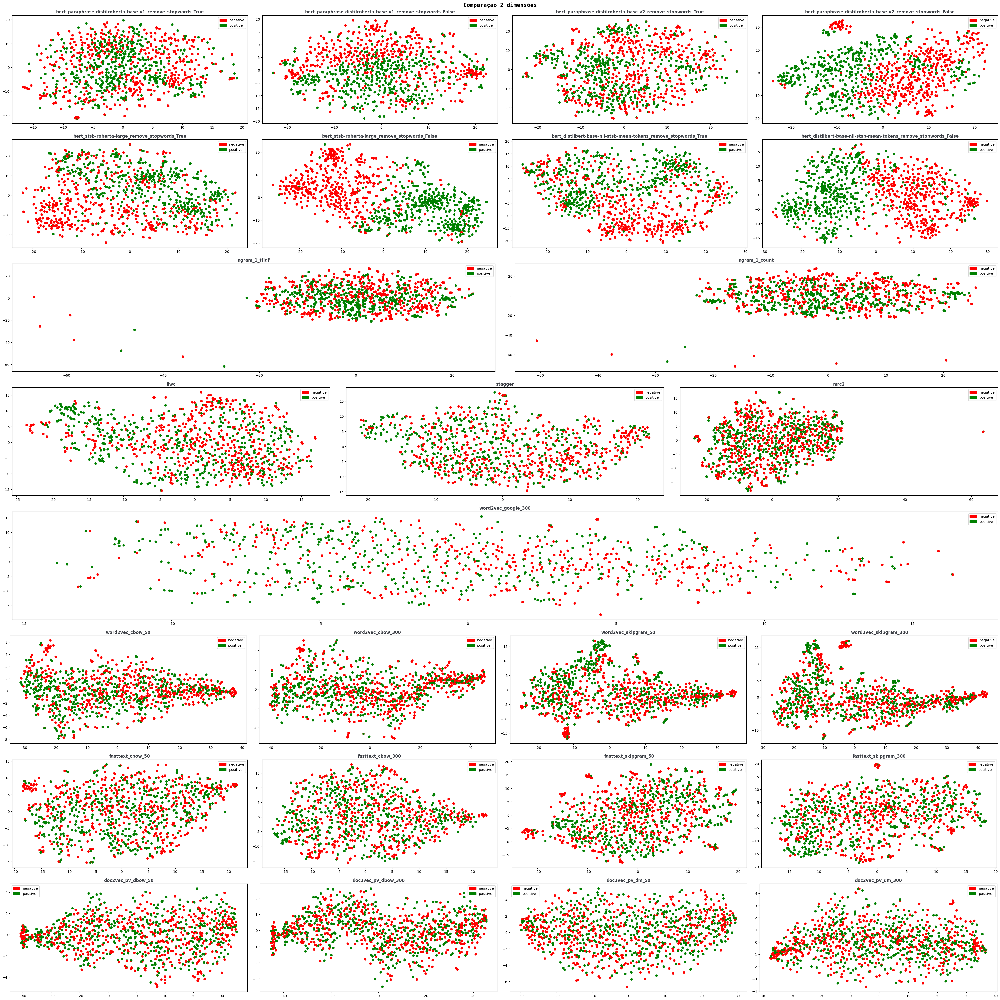

In [164]:
total_rows = len(chart_layout)
fig = plt.figure(constrained_layout=True, figsize=(5 * total_rows, 40))
subfigs = fig.subfigures(nrows=total_rows, ncols=1, wspace=1.5)
fig.suptitle("Comparação 2 dimensões", fontweight="bold", fontsize=16, fontfamily="monospace")

for keys, subfig in zip(chart_layout, subfigs):
    total_plot_cols = len(keys)
    for jdx, key in enumerate(keys, start=1):
        tsne_value = tsne_2[key]
                
        ax = subfig.add_subplot(1, total_plot_cols, jdx) 
        x, y = np.split(tsne_value, 2, axis=1)
        ax.scatter(x, y, c=["red" if str(label) == "0" else "green" for label in df["label"]], marker="o")
                
        ax.set_title(key, fontdict={"color":"#3c3f45", "fontsize":12, "fontweight":"semibold"})
        plt.legend(handles=[mpatches.Patch(color=color, label=label) for color, label in [["red", "negative"], ["green", "positive"]]])

### Comparação interativa

In [165]:
figs_2d = []

for title in ["Representação_1", "Representação_2"]:
    temp_fig = plot_comparison(
        tsne_2,
        lambda data: go.Scatter(
            x=data[:, 0],
            y=data[:, 1],
            mode="markers",
            marker=dict(  
                size=12,
                color=["red" if str(label) == "0" else "green" for label in df["label"]]
            ),
            visible=False
        )
    )

    
    temp_fig.update_layout(
        showlegend=False,
        width=1180,
        height=900,
        autosize=True,
        margin=dict(
            t=1
        ),
        title=dict(
            text=title,
            x=0.5,
            automargin=True,
            font=dict(
                size=24,
            )

        )
    )
    
    figs_2d.append(temp_fig)


widgets.VBox(
    [
        widgets.HTML("<h2 style='background-color:white;color:black;text-align:center'>TSNE - 2 Dimensões</h2>"),
        widgets.HBox(
            figs_2d
        )
    ],
)

## TSNE 3 Dimensões

### Consolidado TSNE 3 dimensões

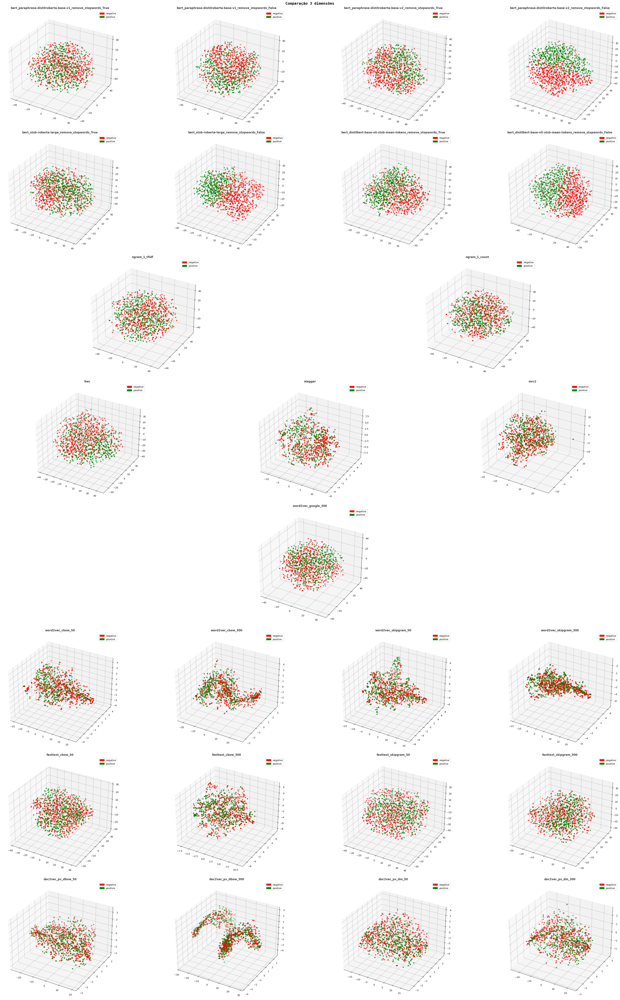

In [166]:
fig = plt.figure(constrained_layout=True, figsize=(5 * total_rows, 60))
subfigs = fig.subfigures(nrows=len(chart_layout), ncols=1, wspace=1.5)
fig.suptitle("Comparação 3 dimensões", fontweight="bold", fontsize=16, fontfamily="monospace")

for keys, subfig in zip(chart_layout, subfigs):
    total_plot_cols = len(keys)    
    for jdx, key in enumerate(keys, start=1):
        tsne_value = tsne_3[key]
        ax = subfig.add_subplot(1, total_plot_cols, jdx, projection="3d")
        x, y, z = np.split(tsne_value, 3, axis=1)
        ax.scatter(x, y, z, c=["red" if str(label) == "0" else "green" for label in df["label"]], marker="o")
                
        ax.set_title(key, fontdict={"color":"#3c3f45", "fontsize":12, "fontweight":"semibold"})
        plt.legend(handles=[mpatches.Patch(color=color, label=label) for color, label in [["red", "negative"], ["green", "positive"]]])

### Comparação interativa

In [167]:
figs_3d = []

for title in ["Representação_1", "Representação_2"]:
    temp_fig = plot_comparison(
        tsne_3,
        lambda data: go.Scatter3d(
            x=data[:, 0],
            y=data[:, 1],
            z=data[:, 2],
            mode="markers",
            marker=dict(  
                size=12,
                color=["red" if str(label) == "0" else "green" for label in df["label"]]
            ),
            visible=False
        )
    )

    
    temp_fig.update_layout(
        showlegend=False,
        width=1180,
        height=900,
        autosize=True,
        margin=dict(
            t=1
        ),
        title=dict(
            text=title,
            x=0.5,
            automargin=True,
            font=dict(
                size=24,
            )

        )
    )
    
    figs_3d.append(temp_fig)


widgets.VBox(
    [
        widgets.HTML("<h2 style='background-color:white;color:black;text-align:center'>TSNE - 3 Dimensões</h2>"),
        widgets.HBox(
            figs_3d
        )
    ],
)

## Comparação TSNE 2 dimensões x TSNE 3 dimensões

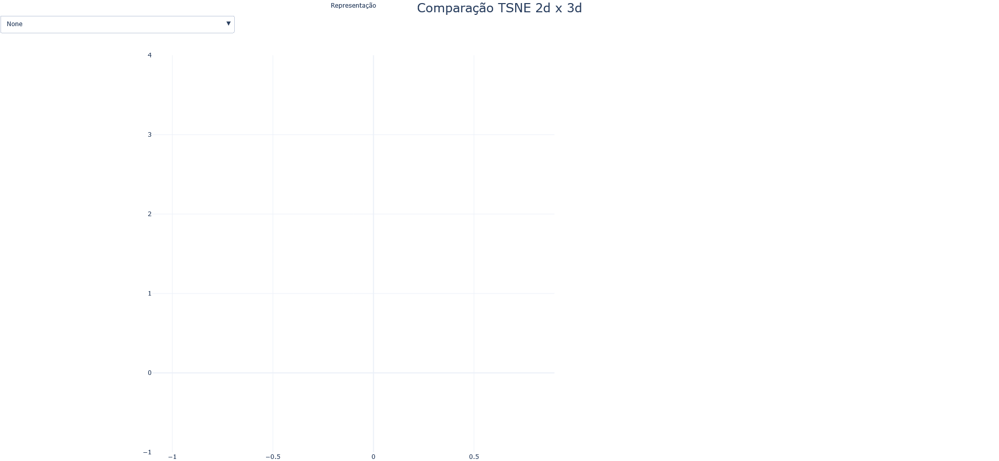

In [168]:
pfig = make_subplots(
    cols=2, 
    rows=1, 
    specs=[
        [
            {}, 
            {
                "type": "surface"
            }
        ]
    ],
    horizontal_spacing=0.05
)

for representation_model in representations_dict.keys():
    representation_model_tsne = tsne_2[representation_model]
    
    pfig.add_traces(    
        go.Scatter(
            dict(
                x=representation_model_tsne[:, 0],
                y=representation_model_tsne[:, 1],
                mode="markers",
                marker=dict(
                    size=12,
                    color=["red" if str(label) == "0" else "green" for label in df["label"]]
                ),
                visible=False
            )
        ), cols=1, rows=1
    )
    
    representation_model_tsne = tsne_3[representation_model]
    
    pfig.add_traces(
        go.Scatter3d(    
            x=representation_model_tsne[:, 0],
            y=representation_model_tsne[:, 1],
            z=representation_model_tsne[:, 2],
            mode="markers",
            marker=dict(
                size=12,
                color=["red" if str(label) == "0" else "green" for label in df["label"]]
            ),
            visible=False
        ), cols=2, rows=1
    )
    

pfig.update_layout(
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    label="None",
                    args=[{"visible": [False for i in range(len(representations_dict.keys()) * 2)]}],
                    method="update"
                ),
                *[
                    dict(
                        label=model,
                        args=[{"visible": [i == idx * 2  or i == ((idx * 2) + 1)  for i in range(len(representations_dict) * 2)]}],
                        method="update"
                    ) for idx, model in enumerate(representations_dict.keys())
                ]
            ]),
            direction="down",
            showactive=True,
            xanchor="left",
            x=-0.18,
            y=1.1
        )
    ]
)


pfig.update_layout(
    annotations=[
         dict(
            text="Representação",
            showarrow=False,
            align="left",
            yref="paper",
            x=-0.1,
            y=1.14,
        )
    ]
)

pfig.update_layout(
    margin=dict(t=10, b=0, l=0, r=0),
    template="plotly_white",
    # paper_bgcolor="LightSteelBlue",
    autosize=True, 
    height=900, 
    showlegend=False,
    title=dict(
        text="Comparação TSNE 2d x 3d",
        x=0.5,
        automargin=True,
        font=dict(
            size=24,
        )
    )
)

pfig.show()

## Comparação tabular das representações

In [169]:
selector_1 = draw_representation_dropdown()
output_1 = widgets.Output()
selector_2 = draw_representation_dropdown()
output_2 = widgets.Output()

def handle_representation_dropdown(change, widget_output):
    if change["type"] == "change" and change["name"] == 'value':        
        selected_df = representations_dict.get(change["new"], pd.DataFrame())
        
        widget_output.outputs = []
        
        if selected_df.empty:
            widget_output.append_display_data(render_empty_table())
            return
        widget_output.append_display_data(
            widgets.HTML(f'<h4 style="font-size:20px">Quantidade de colunas: <strong>{selected_df.shape[1]}</strong></h4>')
        )
        widget_output.append_display_data(selected_df.head(5))
        widget_output.append_display_data(widgets.HTML("<br></br>"))

selector_1.observe(lambda change: handle_representation_dropdown(change, output_1))
selector_2.observe(lambda change: handle_representation_dropdown(change, output_2))

display(
    widgets.VBox(
        [   
            widgets.HTML(render_pandas_html(df, 5)),
            selector_1,
            widgets.HTML("<hr></hr>")
        ]
    ), output_1
)
    
display(
    widgets.VBox(
        [   
            selector_2,
            widgets.HTML("<hr></hr>")
        ]
    ), output_2
)

Output()

Output()